<a href="https://colab.research.google.com/github/icpauline/Realestate/blob/main/Real_Estate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
train_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/test.csv')
test_data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/train.csv')

In [5]:
train_data.head()

,UID,BLOCKID,SUMLEVEL,COUNTYID,STATEID,state,state_ab,city,place,type,...,female_age_mean,female_age_median,female_age_stdev,female_age_sample_weight,female_age_samples,pct_own,married,married_snp,separated,divorced
0,255504,NaN,140,163,26,Michigan,MI,Detroit,Dearborn Heights City,CDP,...,34.78682,33.75000,21.58531,416.48097,1938.0,0.70252,0.28217,0.05910,0.03813,0.14299
1,252676,NaN,140,1,23,Maine,ME,Auburn,Auburn City,City,...,44.23451,46.66667,22.37036,532.03505,1950.0,0.85128,0.64221,0.02338,0.00000,0.13377
2,276314,NaN,140,15,42,Pennsylvania,PA,Pine City,Millerton,Borough,...,41.62426,44.50000,22.86213,453.11959,1879.0,0.81897,0.59961,0.01746,0.01358,0.10026
3,248614,NaN,140,231,21,Kentucky,KY,Monticello,Monticello City,City,...,44.81200,48.00000,21.03155,263.94320,1081.0,0.84609,0.56953,0.05492,0.04694,0.12489
4,286865,NaN,140,355,48,Texas,TX,Corpus Christi,Edroy,Town,...,40.66618,42.66667,21.30900,709.90829,2956.0,0.79077,0.57620,0.01726,0.00588,0.16379


In [6]:
train_data.shape

(11709, 80)

In [7]:
test_data.head()

,UID,BLOCKID,SUMLEVEL,COUNTYID,STATEID,state,state_ab,city,place,type,...,female_age_mean,female_age_median,female_age_stdev,female_age_sample_weight,female_age_samples,pct_own,married,married_snp,separated,divorced
0,267822,NaN,140,53,36,New York,NY,Hamilton,Hamilton,City,...,44.48629,45.33333,22.51276,685.33845,2618.0,0.79046,0.57851,0.01882,0.01240,0.08770
1,246444,NaN,140,141,18,Indiana,IN,South Bend,Roseland,City,...,36.48391,37.58333,23.43353,267.23367,1284.0,0.52483,0.34886,0.01426,0.01426,0.09030
2,245683,NaN,140,63,18,Indiana,IN,Danville,Danville,City,...,42.15810,42.83333,23.94119,707.01963,3238.0,0.85331,0.64745,0.02830,0.01607,0.10657
3,279653,NaN,140,127,72,Puerto Rico,PR,San Juan,Guaynabo,Urban,...,47.77526,50.58333,24.32015,362.20193,1559.0,0.65037,0.47257,0.02021,0.02021,0.10106
4,247218,NaN,140,161,20,Kansas,KS,Manhattan,Manhattan City,City,...,24.17693,21.58333,11.10484,1854.48652,3051.0,0.13046,0.12356,0.00000,0.00000,0.03109


In [8]:
test_data.shape

(27321, 80)

In [9]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11709 entries, 0 to 11708
Data columns (total 80 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   UID                          11709 non-null  int64  
 1   BLOCKID                      0 non-null      float64
 2   SUMLEVEL                     11709 non-null  int64  
 3   COUNTYID                     11709 non-null  int64  
 4   STATEID                      11709 non-null  int64  
 5   state                        11709 non-null  object 
 6   state_ab                     11709 non-null  object 
 7   city                         11709 non-null  object 
 8   place                        11709 non-null  object 
 9   type                         11709 non-null  object 
 10  primary                      11709 non-null  object 
 11  zip_code                     11709 non-null  int64  
 12  area_code                    11709 non-null  int64  
 13  lat             

In [10]:
train_data.isnull().sum()

UID                0
BLOCKID        11709
SUMLEVEL           0
COUNTYID           0
STATEID            0
               ...  
pct_own          122
married           84
married_snp       84
separated         84
divorced          84
Length: 80, dtype: int64

In [11]:
test_data.isnull().sum()

UID                0
BLOCKID        27321
SUMLEVEL           0
COUNTYID           0
STATEID            0
               ...  
pct_own          268
married          191
married_snp      191
separated        191
divorced         191
Length: 80, dtype: int64

In [12]:
train_data.isnull().sum()/len(train_data)*100

UID              0.000000
BLOCKID        100.000000
SUMLEVEL         0.000000
COUNTYID         0.000000
STATEID          0.000000
                  ...    
pct_own          1.041934
married          0.717397
married_snp      0.717397
separated        0.717397
divorced         0.717397
Length: 80, dtype: float64

In [13]:
test_data.isnull().sum()/len(test_data)*100

UID              0.000000
BLOCKID        100.000000
SUMLEVEL         0.000000
COUNTYID         0.000000
STATEID          0.000000
                  ...    
pct_own          0.980930
married          0.699096
married_snp      0.699096
separated        0.699096
divorced         0.699096
Length: 80, dtype: float64

In [14]:
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns', None)

In [15]:
train_data.isnull().sum()/len(train_data)*100

UID                              0.000000
BLOCKID                        100.000000
SUMLEVEL                         0.000000
COUNTYID                         0.000000
STATEID                          0.000000
state                            0.000000
state_ab                         0.000000
city                             0.000000
place                            0.000000
type                             0.000000
primary                          0.000000
zip_code                         0.000000
area_code                        0.000000
lat                              0.000000
lng                              0.000000
ALand                            0.000000
AWater                           0.000000
pop                              0.000000
male_pop                         0.000000
female_pop                       0.000000
rent_mean                        1.263985
rent_median                      1.263985
rent_stdev                       1.263985
rent_sample_weight               1

### Task: Figure out the primary key and look for the requirement of indexing.

#### UID is the primary key

### Checking for similar data in train and test data

### Gauge the fill rate of the variables

In [16]:
1- (train_data.isna().sum()/len(train_data)*100)

UID                             1.000000
BLOCKID                       -99.000000
SUMLEVEL                        1.000000
COUNTYID                        1.000000
STATEID                         1.000000
state                           1.000000
state_ab                        1.000000
city                            1.000000
place                           1.000000
type                            1.000000
primary                         1.000000
zip_code                        1.000000
area_code                       1.000000
lat                             1.000000
lng                             1.000000
ALand                           1.000000
AWater                          1.000000
pop                             1.000000
male_pop                        1.000000
female_pop                      1.000000
rent_mean                      -0.263985
rent_median                    -0.263985
rent_stdev                     -0.263985
rent_sample_weight             -0.263985
rent_samples    

In [17]:
1- (test_data.isna().sum()/len(test_data)*100)

UID                             1.000000
BLOCKID                       -99.000000
SUMLEVEL                        1.000000
COUNTYID                        1.000000
STATEID                         1.000000
state                           1.000000
state_ab                        1.000000
city                            1.000000
place                           1.000000
type                            1.000000
primary                         1.000000
zip_code                        1.000000
area_code                       1.000000
lat                             1.000000
lng                             1.000000
ALand                           1.000000
AWater                          1.000000
pop                             1.000000
male_pop                        1.000000
female_pop                      1.000000
rent_mean                      -0.149299
rent_median                    -0.149299
rent_stdev                     -0.149299
rent_sample_weight             -0.149299
rent_samples    

### Merging test and train data for missing value treatment

In [18]:
train_data['data type'] = 'Train'
test_data['data type'] = 'Test'

In [19]:
combined_data = train_data.append(test_data, ignore_index = True)

### Dropping BlockID as it's full of null

In [20]:
combined_data.drop(['BLOCKID'] , axis = 1, inplace = True)

In [21]:
combined_data.isna().sum()/len(combined_data)*100

UID                            0.000000
SUMLEVEL                       0.000000
COUNTYID                       0.000000
STATEID                        0.000000
state                          0.000000
state_ab                       0.000000
city                           0.000000
place                          0.000000
type                           0.000000
primary                        0.000000
zip_code                       0.000000
area_code                      0.000000
lat                            0.000000
lng                            0.000000
ALand                          0.000000
AWater                         0.000000
pop                            0.000000
male_pop                       0.000000
female_pop                     0.000000
rent_mean                      1.183705
rent_median                    1.183705
rent_stdev                     1.183705
rent_sample_weight             1.183705
rent_samples                   1.183705
rent_gt_10                     1.186267


### To identify Categorical and numerical variables

In [22]:
col_check=combined_data.isna().sum().to_frame().reset_index()

null_col=col_check[col_check[0]>0]['index'].tolist()

null_col

['rent_mean',
 'rent_median',
 'rent_stdev',
 'rent_sample_weight',
 'rent_samples',
 'rent_gt_10',
 'rent_gt_15',
 'rent_gt_20',
 'rent_gt_25',
 'rent_gt_30',
 'rent_gt_35',
 'rent_gt_40',
 'rent_gt_50',
 'hi_mean',
 'hi_median',
 'hi_stdev',
 'hi_sample_weight',
 'hi_samples',
 'family_mean',
 'family_median',
 'family_stdev',
 'family_sample_weight',
 'family_samples',
 'hc_mortgage_mean',
 'hc_mortgage_median',
 'hc_mortgage_stdev',
 'hc_mortgage_sample_weight',
 'hc_mortgage_samples',
 'hc_mean',
 'hc_median',
 'hc_stdev',
 'hc_samples',
 'hc_sample_weight',
 'home_equity_second_mortgage',
 'second_mortgage',
 'home_equity',
 'debt',
 'second_mortgage_cdf',
 'home_equity_cdf',
 'debt_cdf',
 'hs_degree',
 'hs_degree_male',
 'hs_degree_female',
 'male_age_mean',
 'male_age_median',
 'male_age_stdev',
 'male_age_sample_weight',
 'male_age_samples',
 'female_age_mean',
 'female_age_median',
 'female_age_stdev',
 'female_age_sample_weight',
 'female_age_samples',
 'pct_own',
 'married'

### Filling categorical columns(unique value <=8) with mode and numerical with median

In [23]:
for i in null_col:
    print(i)
    if combined_data[i].nunique()> 8:
        combined_data.fillna(combined_data[i].median(), inplace = True)
    else:
        combined_data.fillna(combined_data[i].mode(), inplace = True) 

rent_mean
rent_median
rent_stdev
rent_sample_weight
rent_samples
rent_gt_10
rent_gt_15
rent_gt_20
rent_gt_25
rent_gt_30
rent_gt_35
rent_gt_40
rent_gt_50
hi_mean
hi_median
hi_stdev
hi_sample_weight
hi_samples
family_mean
family_median
family_stdev
family_sample_weight
family_samples
hc_mortgage_mean
hc_mortgage_median
hc_mortgage_stdev
hc_mortgage_sample_weight
hc_mortgage_samples
hc_mean
hc_median
hc_stdev
hc_samples
hc_sample_weight
home_equity_second_mortgage
second_mortgage
home_equity
debt
second_mortgage_cdf
home_equity_cdf
debt_cdf
hs_degree
hs_degree_male
hs_degree_female
male_age_mean
male_age_median
male_age_stdev
male_age_sample_weight
male_age_samples
female_age_mean
female_age_median
female_age_stdev
female_age_sample_weight
female_age_samples
pct_own
married
married_snp
separated
divorced


In [24]:
combined_data.isnull().sum()

UID                            0
SUMLEVEL                       0
COUNTYID                       0
STATEID                        0
state                          0
state_ab                       0
city                           0
place                          0
type                           0
primary                        0
zip_code                       0
area_code                      0
lat                            0
lng                            0
ALand                          0
AWater                         0
pop                            0
male_pop                       0
female_pop                     0
rent_mean                      0
rent_median                    0
rent_stdev                     0
rent_sample_weight             0
rent_samples                   0
rent_gt_10                     0
rent_gt_15                     0
rent_gt_20                     0
rent_gt_25                     0
rent_gt_30                     0
rent_gt_35                     0
rent_gt_40

In [25]:
combined_data.shape

(39030, 80)

In [26]:
combined_data.drop_duplicates(inplace = True)

In [27]:
combined_data.shape

(38838, 80)

In [28]:
combined_data.drop_duplicates(subset= ['UID'], inplace = True)
combined_data.shape

(38715, 80)

In [29]:
combined_data.head()

,UID,SUMLEVEL,COUNTYID,STATEID,state,state_ab,city,place,type,primary,zip_code,area_code,lat,lng,ALand,AWater,pop,male_pop,female_pop,rent_mean,rent_median,rent_stdev,rent_sample_weight,rent_samples,rent_gt_10,rent_gt_15,rent_gt_20,rent_gt_25,rent_gt_30,rent_gt_35,rent_gt_40,rent_gt_50,universe_samples,used_samples,hi_mean,hi_median,hi_stdev,hi_sample_weight,hi_samples,family_mean,family_median,family_stdev,family_sample_weight,family_samples,hc_mortgage_mean,hc_mortgage_median,hc_mortgage_stdev,hc_mortgage_sample_weight,hc_mortgage_samples,hc_mean,hc_median,hc_stdev,hc_samples,hc_sample_weight,home_equity_second_mortgage,second_mortgage,home_equity,debt,second_mortgage_cdf,home_equity_cdf,debt_cdf,hs_degree,hs_degree_male,hs_degree_female,male_age_mean,male_age_median,male_age_stdev,male_age_sample_weight,male_age_samples,female_age_mean,female_age_median,female_age_stdev,female_age_sample_weight,female_age_samples,pct_own,married,married_snp,separated,divorced,data type
0,255504,140,163,26,Michigan,MI,Detroit,Dearborn Heights City,CDP,tract,48239,313,42.346422,-83.252823,2711280.0,39555,3417,1479,1938,858.57169,859.0,232.39082,276.07497,424.0,1.00000,0.95696,0.85316,0.85316,0.85316,0.85316,0.76962,0.63544,435,395,48899.52121,38746.0,44392.20902,798.02401,1180.0,53802.87122,45167.0,43756.56479,464.30972,769.0,1139.24548,1109.0,336.47710,262.67011,474.0,488.51323,436.0,192.75147,271.0,189.18182,0.06443,0.06443,0.07651,0.63624,0.14111,0.55087,0.51965,0.91047,0.92010,0.90391,33.37131,27.83333,22.36768,334.30978,1479.0,34.78682,33.75000,21.58531,416.48097,1938.0,0.70252,0.28217,0.05910,0.03813,0.14299,Train
1,252676,140,1,23,Maine,ME,Auburn,Auburn City,City,tract,4210,207,44.100724,-70.257832,14778785.0,2705204,3796,1846,1950,832.68625,750.0,267.22342,183.32299,245.0,1.00000,1.00000,0.86611,0.67364,0.30962,0.30962,0.30962,0.27197,275,239,72335.33234,61008.0,51895.81159,922.82969,1722.0,85642.22095,74759.0,49156.72870,482.99945,1147.0,1533.25988,1438.0,536.61118,373.96188,937.0,661.31296,668.0,201.31365,510.0,279.69697,0.01175,0.01175,0.14375,0.64755,0.52310,0.26442,0.49359,0.94290,0.92832,0.95736,43.88680,46.08333,22.90302,427.10824,1846.0,44.23451,46.66667,22.37036,532.03505,1950.0,0.85128,0.64221,0.02338,0.00000,0.13377,Train
2,276314,140,15,42,Pennsylvania,PA,Pine City,Millerton,Borough,tract,14871,607,41.948556,-76.783808,258903666.0,863840,3944,2065,1879,816.00639,755.0,416.25699,141.39063,217.0,0.97573,0.93204,0.78641,0.71845,0.63592,0.47573,0.43689,0.32524,245,206,58501.15901,51648.0,45245.27248,893.07759,1461.0,65694.06582,57186.0,44239.31893,619.73962,1084.0,1254.54462,1089.0,596.85204,340.45884,552.0,397.44466,356.0,189.40372,664.0,534.16737,0.01069,0.01316,0.06497,0.45395,0.51066,0.60484,0.83848,0.89238,0.86003,0.92463,39.81661,41.91667,24.29111,499.10080,2065.0,41.62426,44.50000,22.86213,453.11959,1879.0,0.81897,0.59961,0.01746,0.01358,0.10026,Train
3,248614,140,231,21,Kentucky,KY,Monticello,Monticello City,City,tract,42633,606,36.746009,-84.766870,501694825.0,2623067,2508,1427,1081,418.68937,385.0,156.92024,88.95960,93.0,1.00000,0.93548,0.93548,0.64516,0.55914,0.46237,0.46237,0.36559,153,93,38237.55059,31612.0,34527.61607,775.17947,957.0,44156.38709,34687.0,34899.74300,535.21987,689.0,862.65763,749.0,624.42157,299.56752,337.0,200.88113,180.0,91.56490,467.0,454.85404,0.00995,0.00995,0.01741,0.41915,0.53770,0.80931,0.87403,0.60908,0.56584,0.65947,41.81638,43.00000,24.65325,333.57733,1427.0,44.81200,48.00000,21.03155,263.94320,1081.0,0.84609,0.56953,0.05492,0.04694,0.12489,Train
4,286865,140,355,48,Texas,TX,Corpus Christi,Edroy,Town,tract,78410,361,27.882462,-97.678586,13796057.0,497689,6230,3274,2956,1031.63763,997.0,326.76727,277.39844,624.0,0.72276,0.66506,0.53526,0.38301,0.18910,0.16667,0.14263,0.11058,660,624,114456.07790,94211.0,81950.95692,836.30759,2404.0,123527.02420,103898.0,72173.55823,507.42257,1738.0,1996.41425,1907.0,740.21168,319.97570,1102.0,867.57713,804.0,376.20236,642.0,333.91919,0.00000,0.00000,0.034

## Debt Analysis

##### Explore the top 2,500 locations where the percentage of households with a second mortgage is the highest and percent ownership is above 10 percent. Visualize using geo-map. 
##### You may keep the upper limit for the percent of households with a second mortgage to 50 percent

In [30]:
train_data.nlargest(2500, ['second_mortgage', 'pct_own'] )

,UID,BLOCKID,SUMLEVEL,COUNTYID,STATEID,state,state_ab,city,place,type,primary,zip_code,area_code,lat,lng,ALand,AWater,pop,male_pop,female_pop,rent_mean,rent_median,rent_stdev,rent_sample_weight,rent_samples,rent_gt_10,rent_gt_15,rent_gt_20,rent_gt_25,rent_gt_30,rent_gt_35,rent_gt_40,rent_gt_50,universe_samples,used_samples,hi_mean,hi_median,hi_stdev,hi_sample_weight,hi_samples,family_mean,family_median,family_stdev,family_sample_weight,family_samples,hc_mortgage_mean,hc_mortgage_median,hc_mortgage_stdev,hc_mortgage_sample_weight,hc_mortgage_samples,hc_mean,hc_median,hc_stdev,hc_samples,hc_sample_weight,home_equity_second_mortgage,second_mortgage,home_equity,debt,second_mortgage_cdf,home_equity_cdf,debt_cdf,hs_degree,hs_degree_male,hs_degree_female,male_age_mean,male_age_median,male_age_stdev,male_age_sample_weight,male_age_samples,female_age_mean,female_age_median,female_age_stdev,female_age_sample_weight,female_age_samples,pct_own,married,married_snp,separated,divorced,data type
934,247937,NaN,140,93,21,Kentucky,KY,Fort Knox,Fort Knox,City,tract,40121,502,37.879246,-85.961748,10129479,7700,3937,1808,2129,1196.96888,1173.0,329.32165,342.04691,1006.0,0.97001,0.88418,0.69907,0.49121,0.36711,0.29886,0.19752,0.13650,1110,967,61478.21044,53248.0,37451.20023,670.39860,1125.0,63273.30137,55270.0,36398.66402,590.13663,1035.0,1412.00000,1406.0,114.79148,5.96386,15.0,NaN,NaN,NaN,NaN,NaN,1.00000,1.00000,1.00000,1.00000,0.00000,0.00000,0.00000,0.93870,0.94002,0.93736,24.24531,25.91667,15.13769,372.04805,1808.0,22.33822,20.91667,14.99343,509.74299,2129.0,0.01067,0.85223,0.04275,0.00000,0.05576,Train
8247,248394,NaN,140,163,21,Kentucky,KY,Fort Knox,Fort Knox,City,tract,40121,502,37.901474,-85.986474,4114191,8502,2661,1280,1381,1118.09185,1039.0,272.97314,262.35860,718.0,1.00000,0.93454,0.78552,0.57103,0.49025,0.36351,0.24234,0.11838,796,718,48184.50734,44822.0,24841.69744,578.68043,798.0,50819.49924,46983.0,23710.51317,526.18373,744.0,449.50000,449.0,36.51484,2.00000,2.0,NaN,NaN,NaN,NaN,NaN,1.00000,1.00000,1.00000,1.00000,0.00000,0.00000,0.00000,0.96933,0.96314,0.97500,22.84809,24.50000,13.06332,289.82619,1280.0,23.05701,25.25000,13.75385,312.77660,1381.0,0.00225,0.82381,0.03214,0.00000,0.01429,Train
6238,266140,NaN,140,5,36,New York,NY,Bronx,Mount Vernon City,City,tract,10452,718,40.842166,-73.926952,282706,0,4340,2015,2325,1008.83002,1063.0,436.70762,533.24714,1224.0,0.95649,0.88954,0.80502,0.71464,0.59916,0.47113,0.44017,0.36904,1273,1195,38498.09650,22879.0,43298.48925,1001.58754,1307.0,43968.15257,35084.0,39337.97306,691.64274,947.0,2631.10494,2661.0,269.99294,5.35671,27.0,1249.50000,1249.0,36.51484,7.0,3.46465,0.00000,0.58824,0.00000,0.79412,0.00045,1.00000,0.16727,0.67646,0.67666,0.67631,32.06012,27.66667,21.71151,522.32040,2015.0,33.88806,33.00000,21.64432,502.50584,2325.0,0.03028,0.32942,0.10635,0.03522,0.06837,Train
1208,274394,NaN,140,109,40,Oklahoma,OK,Edmond,Edmond City,CDP,tract,73003,405,35.655695,-97.471535,1303767,0,1498,765,733,733.70891,657.0,280.13683,310.27766,369.0,0.95882,0.87647,0.85000,0.66176,0.60882,0.47059,0.37647,0.31471,373,340,36987.89322,26534.0,33223.68597,291.81725,398.0,69473.91845,68645.0,36742.01054,51.02955,107.0,1870.63900,1109.0,1155.88607,14.57433,25.0,NaN,NaN,NaN,NaN,NaN,0.40000,0.40000,0.40000,1.00000,0.00121,0.00660,0.00000,0.85905,0.83380,0.91176,29.65095,23.75000,13.48421,292.05486,765.0,25.15867,20.33333,14.45893,353.85896,733.0,0.10483,0.14094,0.06443,0.01879,0.07114,Train
9088,248877,NaN,140,33,22,Louisiana,LA,Baton Rouge,Port Allen City,City,tract,70802,225,30.414676,-91.192011,2990697,577503,3234,1594,1640,762.89673,681.0,294.83904,827.17235,983.0,0.96513,0.84702,0.64679,0.56918,0.47919,0.44657,0.40382,0.33183,1007,889,31506.85234,27326.0,24225.21251,785.92257,1025.0,37265.72341,30743.0,27325.71091,282.46100,359.0,1141.54196,1290.0,338.19064,8.78313,13.0,53.59461,53.0,24.62293,5.0,2.45000,0.38889,0.38889,0.38889,0.72222,0.00133,0.00759,0.31537,0.95450,0.94864,0.96218,24.63813,22.58333,9.033

In [31]:
combined_data.nlargest(2500, ['second_mortgage', 'pct_own'])


,UID,SUMLEVEL,COUNTYID,STATEID,state,state_ab,city,place,type,primary,zip_code,area_code,lat,lng,ALand,AWater,pop,male_pop,female_pop,rent_mean,rent_median,rent_stdev,rent_sample_weight,rent_samples,rent_gt_10,rent_gt_15,rent_gt_20,rent_gt_25,rent_gt_30,rent_gt_35,rent_gt_40,rent_gt_50,universe_samples,used_samples,hi_mean,hi_median,hi_stdev,hi_sample_weight,hi_samples,family_mean,family_median,family_stdev,family_sample_weight,family_samples,hc_mortgage_mean,hc_mortgage_median,hc_mortgage_stdev,hc_mortgage_sample_weight,hc_mortgage_samples,hc_mean,hc_median,hc_stdev,hc_samples,hc_sample_weight,home_equity_second_mortgage,second_mortgage,home_equity,debt,second_mortgage_cdf,home_equity_cdf,debt_cdf,hs_degree,hs_degree_male,hs_degree_female,male_age_mean,male_age_median,male_age_stdev,male_age_sample_weight,male_age_samples,female_age_mean,female_age_median,female_age_stdev,female_age_sample_weight,female_age_samples,pct_own,married,married_snp,separated,divorced,data type
70,247510,140,209,20,Kansas,KS,Kansas City,Kansas City City,City,tract,66104,913,39.171767,-94.680617,8.005557e+06,1678971,0,0,0,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,0,0,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,Train
120,281635,140,37,47,Tennessee,TN,Nashville,Nashville-davidson Metropolitan Government,City,tract,37209,615,36.179041,-86.883456,1.483311e+07,1085155,1332,1257,75,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,0,0,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,0.64225,0.62918,0.87143,43.20423,41.50000,12.16400,269.23539,1257.00000,39.33872,39.66667,5.75119,14.62228,75.00000,952.97409,0.28242,0.28242,0.05012,0.29276,Train
153,253631,140,65,26,Michigan,MI,East Lansing,East Lansing City,CDP,tract,48823,517,42.724476,-84.464366,1.978800e+05,0,3368,1759,1609,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,0,0,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,19.03895,18.91667,1.27419,939.97391,1759.00000,18.94500,18.83333,1.14042,847.97640,1609.00000,952.97409,0.00000,0.00000,0.00000,0.00000,Train
292,266664,140,27,36,New York,NY,Poughquag,Hopewell Junction,City,tract,12570,845,41.578838,-73.722796,3.206552e+06,62329,1843,1843,0,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,0,0,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,0.70051,0.70051,952.97409,43.06144,43.50000,10.84415,379.82442,1843.00000,952.97409,952.97409,952.97409,952.97409,952.97409,952.97409,0.30982,0.30982,0.04883,0.19045,Train
463,240928,140,3,15,Hawaii,HI,Kapolei,Kalaeloa,CDP,tract,96707,808,21.306563,-158.109078,5.797098e+06,2519490,0,0,0,952.97409,952.97409,952.97

In [32]:
top_2500 = combined_data[['state', 'lat', 'lng', 'second_mortgage', 'pct_own', 'place', 'state', 'city', 'COUNTYID', 'STATEID', 'home_equity', 'home_equity_second_mortgage', 'debt', 'hi_median', 'family_median']].nlargest(2500, ['second_mortgage', 'pct_own'])
top_2500.head()

,state,lat,lng,second_mortgage,pct_own,place,state,city,COUNTYID,STATEID,home_equity,home_equity_second_mortgage,debt,hi_median,family_median
70,Kansas,39.171767,-94.680617,952.97409,952.97409,Kansas City City,Kansas,Kansas City,209,20,952.97409,952.97409,952.97409,952.97409,952.97409
120,Tennessee,36.179041,-86.883456,952.97409,952.97409,Nashville-davidson Metropolitan Government,Tennessee,Nashville,37,47,952.97409,952.97409,952.97409,952.97409,952.97409
153,Michigan,42.724476,-84.464366,952.97409,952.97409,East Lansing City,Michigan,East Lansing,65,26,952.97409,952.97409,952.97409,952.97409,952.97409
292,New York,41.578838,-73.722796,952.97409,952.97409,Hopewell Junction,New York,Poughquag,27,36,952.97409,952.97409,952.97409,952.97409,952.97409
463,Hawaii,21.306563,-158.109078,952.97409,952.97409,Kalaeloa,Hawaii,Kapolei,3,15,952.97409,952.97409,952.97409,952.97409,952.97409


In [33]:
top_2500.pct_own.unique()

array([9.5297409e+02, 0.0000000e+00, 1.2130000e-02, ..., 8.8118000e-01,
       8.4535000e-01, 6.6590000e-01])

In [34]:
top_2500_filter = top_2500[top_2500.pct_own > 0.1]
top_2500_filter.head()

,state,lat,lng,second_mortgage,pct_own,place,state,city,COUNTYID,STATEID,home_equity,home_equity_second_mortgage,debt,hi_median,family_median
70,Kansas,39.171767,-94.680617,952.97409,952.97409,Kansas City City,Kansas,Kansas City,209,20,952.97409,952.97409,952.97409,952.97409,952.97409
120,Tennessee,36.179041,-86.883456,952.97409,952.97409,Nashville-davidson Metropolitan Government,Tennessee,Nashville,37,47,952.97409,952.97409,952.97409,952.97409,952.97409
153,Michigan,42.724476,-84.464366,952.97409,952.97409,East Lansing City,Michigan,East Lansing,65,26,952.97409,952.97409,952.97409,952.97409,952.97409
292,New York,41.578838,-73.722796,952.97409,952.97409,Hopewell Junction,New York,Poughquag,27,36,952.97409,952.97409,952.97409,952.97409,952.97409
463,Hawaii,21.306563,-158.109078,952.97409,952.97409,Kalaeloa,Hawaii,Kapolei,3,15,952.97409,952.97409,952.97409,952.97409,952.97409


In [35]:
import plotly.graph_objects as go
import plotly.figure_factory as ff

In [36]:
values = top_2500['second_mortgage'].tolist()

# fips = top_2500['FIPSID'].tolist()

##### b ) Use the following bad debt equation: 
##### Bad Debt = P (Second Mortgage ∩ Home Equity Loan) Bad Debt = second_mortgage + home_equity - home_equity_second_mortgage 


In [37]:
# median_age=((male_age_median * male_pop)+(female_age_median*female_pop))/(male_pop+female_pop)

In [38]:
top_2500['Bad_Debt'] = top_2500['second_mortgage'] + top_2500['home_equity'] - top_2500['home_equity_second_mortgage']
top_2500['Good_Debt'] = top_2500['debt'] - top_2500['Bad_Debt']

In [39]:
top_2500.tail()

,state,lat,lng,second_mortgage,pct_own,place,state,city,COUNTYID,STATEID,home_equity,home_equity_second_mortgage,debt,hi_median,family_median,Bad_Debt,Good_Debt
28625,Delaware,39.132430,-75.538142,0.08517,0.64233,Rodney Village,Delaware,Dover,1,10,0.22292,0.08097,0.68875,53112.0,61774.0,0.22712,0.46163
5067,Pennsylvania,40.341643,-75.928384,0.08517,0.25904,Reading City,Pennsylvania,Reading,11,42,0.25868,0.08517,0.64038,24052.0,23825.0,0.25868,0.38170
14760,Connecticut,41.317811,-72.832236,0.08515,0.88118,East Haven,Connecticut,East Haven,9,9,0.20415,0.08515,0.70306,64267.0,71391.0,0.20415,0.49891
7489,California,36.888534,-119.738629,0.08514,0.84535,Fort Washington,California,Fresno,19,6,0.14730,0.06486,0.80135,101756.0,110224.0,0.16758,0.63377
32658,Louisiana,29.968638,-90.013291,0.08511,0.66590,Arabi,Louisiana,New Orleans,71,22,0.08511,0.08511,0.46809,23898.0,34008.0,0.08511,0.38298


##### c) Create pie charts to show overall debt and bad debt

In [40]:
size = 10
explode = [0.4] * size
explode = tuple(explode)
explode

explode_bd = [0.5] * size*2
explode_bd = tuple(explode_bd)
explode_bd

labels_D = ['GD', 'BD'] * size
labels_D = tuple(labels_D)
labels_D

('GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD',
 'GD',
 'BD')

In [41]:
l1 = list(top_2500['Bad_Debt'] )
l1[:5]

[952.9740899999999,
 952.9740899999999,
 952.9740899999999,
 952.9740899999999,
 952.9740899999999]

In [42]:
l2 = list(top_2500['Good_Debt'] )
l2[:5]

[0.0, 0.0, 0.0, 0.0, 0.0]

In [43]:
l3 = sum(zip(l1, l2+[0]), ())

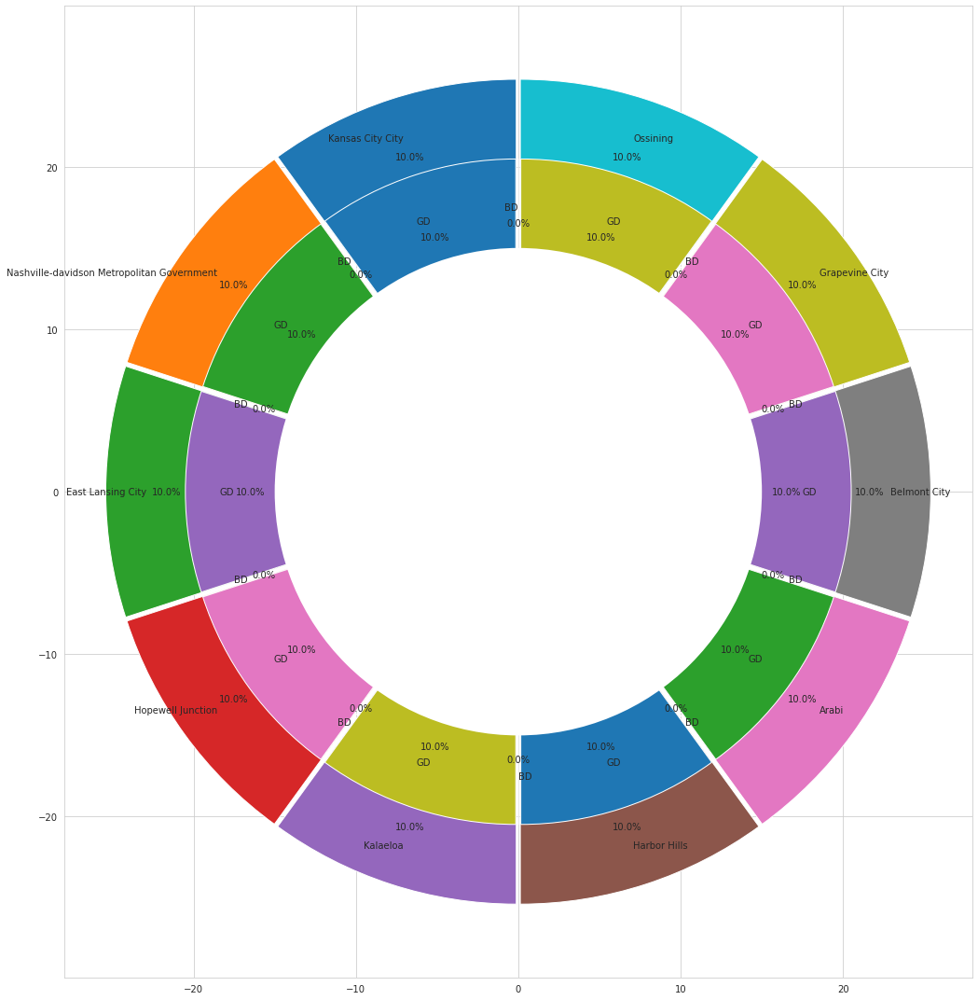

In [44]:
labels = list(top_2500.place[:10])
debt = list(top_2500.debt[:10])

sns.set_style("whitegrid")

gd_bd = l3[:20]

plt.figure(figsize = (15, 15))

color_pal = plt.rcParams['axes.prop_cycle'].by_key()['color']
#color_cycle = cycle(plt.rcParams['axes.prop_cycle'].by_key()['color'])

plt.pie(debt, labels = labels, startangle = 90, frame = True, radius =25, autopct='%1.1f%%', pctdistance=0.85, labeldistance = 0.9, colors = color_pal, explode = explode)
plt.pie(gd_bd, labels = labels_D, startangle = 90, frame = True, radius = 20, autopct='%1.1f%%', pctdistance=0.80,  labeldistance = 0.85, colors = color_pal, explode = explode_bd)
centre_circle = plt.Circle((0,0),15,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.axis('equal')
plt.tight_layout()
plt.show()

##### e)Create Box and whisker plot and analyze the distribution for 2nd mortgage, 
##### home equity, good debt, and bad debt for different cities

In [45]:
second_mortgage = list(top_2500.second_mortgage)
home_equity = list(top_2500.home_equity)

Good_Debt = list(top_2500.Good_Debt)
Bad_Debt = list(top_2500.Bad_Debt)

In [46]:
top_2500['city'].value_counts()[:31].index

Index(['Los Angeles', 'Chicago', 'Brooklyn', 'Bronx', 'Washington', 'Miami',
       'Baltimore', 'Cincinnati', 'Aurora', 'Las Vegas', 'Atlanta',
       'Milwaukee', 'San Diego', 'Jacksonville', 'Houston', 'New York',
       'Charlotte', 'Colorado Springs', 'Minneapolis', 'New Orleans',
       'San Francisco', 'Cleveland', 'Newark', 'Dallas', 'Denver', 'Portland',
       'Long Beach', 'Pittsburgh', 'Sacramento', 'Seattle', 'Kansas City'],
      dtype='object')

In [47]:
cities = ['Chicago', 'Los Angeles', 'Washington', 'Brooklyn',
                  'Milwaukee', 'Aurora', 'Jacksonville', 'Denver', 'Charlotte',
                  'Las Vegas', 'Bronx', 'Baltimore', 'Minneapolis',
                  'Cincinnati', 'Long Beach', 'Colorado Springs', 'Sacramento',
                  'San Diego', 'New Orleans', 'Columbus', 'Lowell', 'Orlando',
                  'Portland', 'San Jose', 'Alexandria', 'Dallas', 'Atlanta',
                  'Littleton', 'Miami', 'Oakland', 'Houston']

In [48]:
boxplot_df = top_2500[top_2500['city'].isin (cities)]

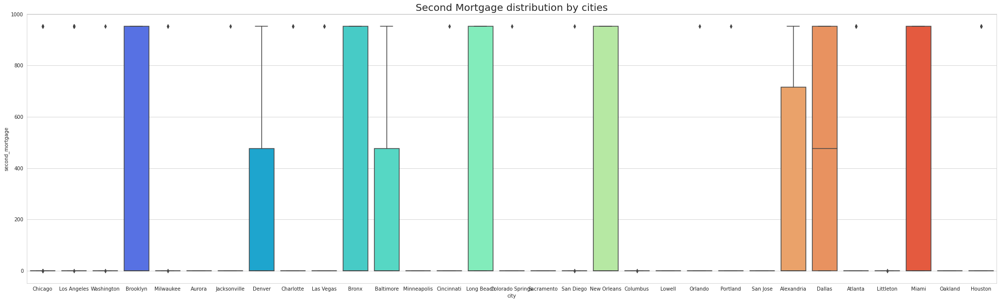

In [49]:
sns.set_style("whitegrid")

plt.figure(figsize = (35, 10))
sns.boxplot(x='city',y='second_mortgage',data=boxplot_df,palette='rainbow', order = ['Chicago', 'Los Angeles', 'Washington', 'Brooklyn',
                  'Milwaukee', 'Aurora', 'Jacksonville', 'Denver', 'Charlotte',
                  'Las Vegas', 'Bronx', 'Baltimore', 'Minneapolis',
                  'Cincinnati', 'Long Beach', 'Colorado Springs', 'Sacramento',
                  'San Diego', 'New Orleans', 'Columbus', 'Lowell', 'Orlando',
                  'Portland', 'San Jose', 'Alexandria', 'Dallas', 'Atlanta',
                  'Littleton', 'Miami', 'Oakland', 'Houston']).set_title('Second Mortgage distribution by cities', fontsize = 20)
plt.show()

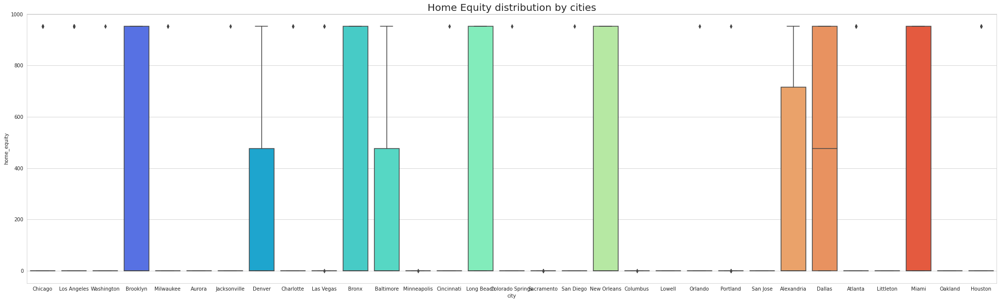

In [50]:
sns.set_style("whitegrid")

plt.figure(figsize = (35, 10))
sns.boxplot(x='city',y='home_equity',data=boxplot_df,palette='rainbow', order = ['Chicago', 'Los Angeles', 'Washington', 'Brooklyn',
                  'Milwaukee', 'Aurora', 'Jacksonville', 'Denver', 'Charlotte',
                  'Las Vegas', 'Bronx', 'Baltimore', 'Minneapolis',
                  'Cincinnati', 'Long Beach', 'Colorado Springs', 'Sacramento',
                  'San Diego', 'New Orleans', 'Columbus', 'Lowell', 'Orlando',
                  'Portland', 'San Jose', 'Alexandria', 'Dallas', 'Atlanta',
                  'Littleton', 'Miami', 'Oakland', 'Houston']).set_title('Home Equity distribution by cities', fontsize = 20)
plt.show()

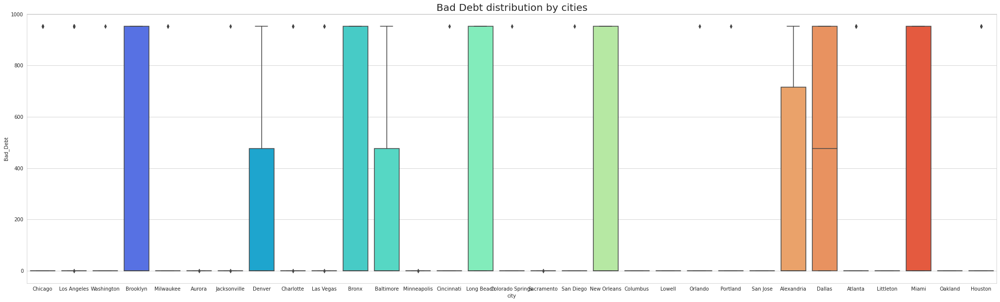

In [51]:
sns.set_style("whitegrid")

plt.figure(figsize = (35, 10))
sns.boxplot(x='city',y='Bad_Debt',data=boxplot_df,palette='rainbow', order = ['Chicago', 'Los Angeles', 'Washington', 'Brooklyn',
                  'Milwaukee', 'Aurora', 'Jacksonville', 'Denver', 'Charlotte',
                  'Las Vegas', 'Bronx', 'Baltimore', 'Minneapolis',
                  'Cincinnati', 'Long Beach', 'Colorado Springs', 'Sacramento',
                  'San Diego', 'New Orleans', 'Columbus', 'Lowell', 'Orlando',
                  'Portland', 'San Jose', 'Alexandria', 'Dallas', 'Atlanta',
                  'Littleton', 'Miami', 'Oakland', 'Houston']).set_title('Bad Debt distribution by cities', fontsize = 20)
plt.show()


##### e) Create a collated income distribution chart for family income, house hold income, and remaining income

In [52]:
top_2500['remaining_income'] = top_2500['family_median'] - top_2500['hi_median']

In [53]:
income_chart = round(top_2500[['city', 'hi_median', 'family_median', 'remaining_income']], 2)
income_chart

,city,hi_median,family_median,remaining_income
70,Kansas City,952.97,952.97,0.00
120,Nashville,952.97,952.97,0.00
153,East Lansing,952.97,952.97,0.00
292,Poughquag,952.97,952.97,0.00
463,Kapolei,952.97,952.97,0.00
533,Corona,952.97,952.97,0.00
660,New Orleans,952.97,952.97,0.00
670,Charlotte,952.97,952.97,0.00
698,Grapevine,952.97,952.97,0.00
979,Ossining,952.97,952.97,0.00


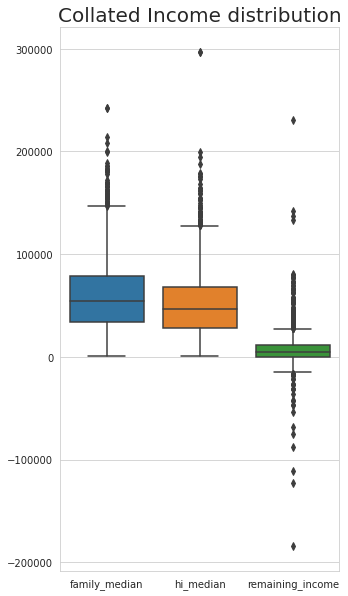

In [54]:
sns.set_style("whitegrid")
plt.figure(figsize = (5, 10))
sns.boxplot(data=top_2500[['family_median', 'hi_median', 'remaining_income']], palette=color_pal).set_title('Collated Income distribution', fontsize = 20)
plt.show()

## Exploratory Data Analysis

### Perform EDA and come out with insights into population density and age. 
### You may have to derive new fields (make sure to weight averages for accurate measurements)
####  a) Use pop and ALand variables to create a new field called population density

In [55]:
train_df = combined_data[combined_data['data type'] == 'Train']
test_df = combined_data[combined_data['data type'] == 'Test']

In [56]:
density_eda_df = train_df[['state', 'city', 'place', 'ALand', 'pop', 'male_age_median', 'female_age_median', 'male_pop', 'female_pop']]
density_eda_df.head()

,state,city,place,ALand,pop,male_age_median,female_age_median,male_pop,female_pop
0,Michigan,Detroit,Dearborn Heights City,2711280.0,3417,27.83333,33.75000,1479,1938
1,Maine,Auburn,Auburn City,14778785.0,3796,46.08333,46.66667,1846,1950
2,Pennsylvania,Pine City,Millerton,258903666.0,3944,41.91667,44.50000,2065,1879
3,Kentucky,Monticello,Monticello City,501694825.0,2508,43.00000,48.00000,1427,1081
4,Texas,Corpus Christi,Edroy,13796057.0,6230,43.75000,42.66667,3274,2956


In [57]:
density_eda_df['pop_density'] = density_eda_df['pop'] / density_eda_df['ALand']
density_eda_df.head()

,state,city,place,ALand,pop,male_age_median,female_age_median,male_pop,female_pop,pop_density
0,Michigan,Detroit,Dearborn Heights City,2711280.0,3417,27.83333,33.75000,1479,1938,0.001260
1,Maine,Auburn,Auburn City,14778785.0,3796,46.08333,46.66667,1846,1950,0.000257
2,Pennsylvania,Pine City,Millerton,258903666.0,3944,41.91667,44.50000,2065,1879,0.000015
3,Kentucky,Monticello,Monticello City,501694825.0,2508,43.00000,48.00000,1427,1081,0.000005
4,Texas,Corpus Christi,Edroy,13796057.0,6230,43.75000,42.66667,3274,2956,0.000452


##### b) Use male_age_median, female_age_median, male_pop, and female_pop to create a new field called median age

In [58]:
density_eda_df['median_age'] = (density_eda_df['male_age_median'] *  density_eda_df['male_pop'] + density_eda_df['female_age_median'] *  density_eda_df['female_pop'])  / density_eda_df['pop']
density_eda_df.head()

,state,city,place,ALand,pop,male_age_median,female_age_median,male_pop,female_pop,pop_density,median_age
0,Michigan,Detroit,Dearborn Heights City,2711280.0,3417,27.83333,33.75000,1479,1938,0.001260,31.189053
1,Maine,Auburn,Auburn City,14778785.0,3796,46.08333,46.66667,1846,1950,0.000257,46.382991
2,Pennsylvania,Pine City,Millerton,258903666.0,3944,41.91667,44.50000,2065,1879,0.000015,43.147420
3,Kentucky,Monticello,Monticello City,501694825.0,2508,43.00000,48.00000,1427,1081,0.000005,45.155104
4,Texas,Corpus Christi,Edroy,13796057.0,6230,43.75000,42.66667,3274,2956,0.000452,43.235983


In [59]:
density_eda_df.nlargest(300, 'pop_density')

,state,city,place,ALand,pop,male_age_median,female_age_median,male_pop,female_pop,pop_density,median_age
2677,Illinois,Chicago,Lincolnwood,8299.0,1457,48.08333,54.91667,702,755,0.175563,51.624285
10983,New York,New York,Mount Vernon City,47273.0,3392,29.25000,27.08333,1464,1928,0.071753,28.018473
10435,New York,New York,New York City,74319.0,5228,46.50000,45.08333,2181,3047,0.070345,45.674332
9183,New York,Bronx,Mount Vernon City,62696.0,4151,28.66667,35.75000,1957,2194,0.066208,32.410545
1992,New York,New York,New York City,171580.0,10402,35.16667,38.25000,4787,5615,0.060625,36.831052
3007,New York,New York,Mount Vernon City,157076.0,9381,32.58333,33.66667,4310,5071,0.059723,33.168941
10134,New York,New York,New York City,51979.0,3081,37.58333,41.66667,1548,1533,0.059274,39.615060
6904,New York,Bronx,Pelham Manor,96381.0,5626,35.33333,31.50000,2656,2970,0.058373,33.309692
240,New York,Bronx,Mount Vernon City,68119.0,3884,33.58333,28.08333,1699,2185,0.057018,30.489226
2341,New York,Brooklyn,New York City,76942.0,4274,31.50000,33.16667,1817,2457,0.055548,32.458121


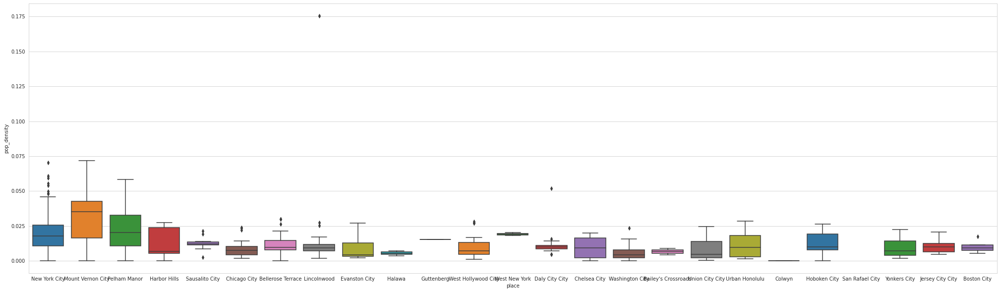

In [60]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))
sns.boxplot(x = 'place', y = 'pop_density', data=density_eda_df.nlargest(26585, 'pop_density'), palette=color_pal, order = ['New York City',
 'Mount Vernon City',
 'Pelham Manor',
 'Harbor Hills',
 'Sausalito City',
 'Chicago City',
 'Bellerose Terrace',
 'Lincolnwood',
 'Evanston City',
 'Halawa',
 'Guttenberg',
 'West Hollywood City',
 'West New York',
 'Daly City City',
 'Chelsea City',
 'Washington City',
 "Bailey's Crossroads",
 'Union City City',
 'Urban Honolulu',
 'Colwyn',
 'Hoboken City',
 'San Rafael City',
 'Yonkers City',
 'Jersey City City',
 'Boston City'])
plt.show()


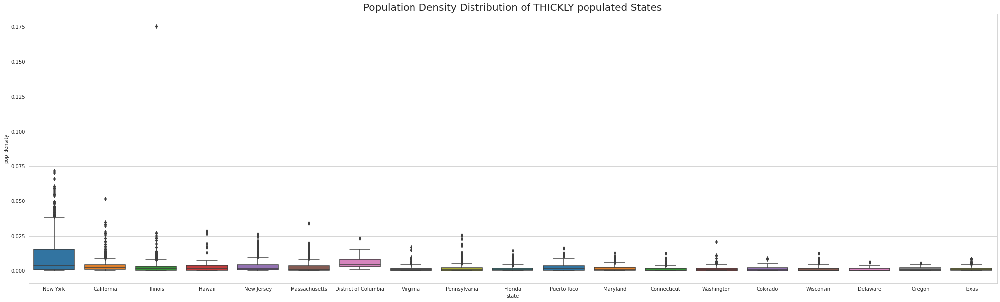

In [61]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))
sns.boxplot(x = 'state', y = 'pop_density', data=density_eda_df.nlargest(26585, 'pop_density'), palette=color_pal, order = ['New York', 'California', 'Illinois', 'Hawaii', 'New Jersey', 'Massachusetts', 'District of Columbia', 'Virginia',
                                                                                                                                                                            'Pennsylvania', 'Florida', 'Puerto Rico', 'Maryland', 'Connecticut', 'Washington', 'Colorado', 'Wisconsin',
                                                                                                                            'Delaware', 'Oregon', 'Texas']).set_title('Population Density Distribution of THICKLY populated States', fontsize = 20)
plt.show()

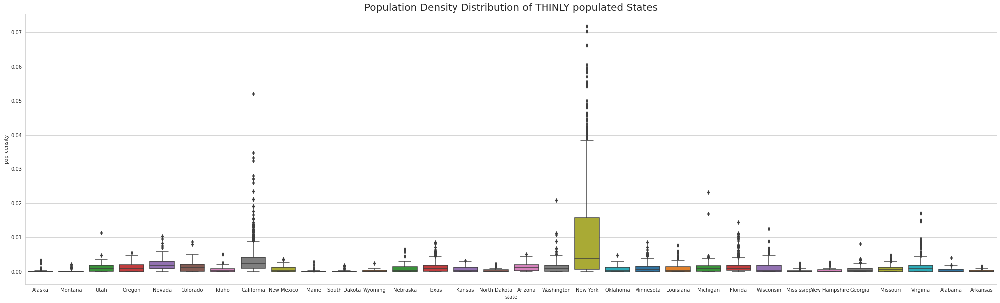

In [62]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))
sns.boxplot(x = 'state', y = 'pop_density', data=density_eda_df.nsmallest(26585, 'pop_density'), palette=color_pal, order = ['Alaska', 'Montana', 'Utah', 'Oregon', 'Nevada', 'Colorado', 'Idaho', 'California', 'New Mexico',
                                                                                                                                                                                 'Maine', 'South Dakota', 'Wyoming', 'Nebraska', 'Texas', 'Kansas', 'North Dakota', 'Arizona',
                                                                                                                                                                                 'Washington', 'New York', 'Oklahoma', 'Minnesota', 'Louisiana', 'Michigan', 'Florida', 'Wisconsin', 'Mississippi',
                                                                                                                                                                                 'New Hampshire', 'Georgia', 'Missouri', 'Virginia', 'Alabama', 'Arkansas']).set_title('Population Density Distribution of THINLY populated States', fontsize = 20)
plt.show()


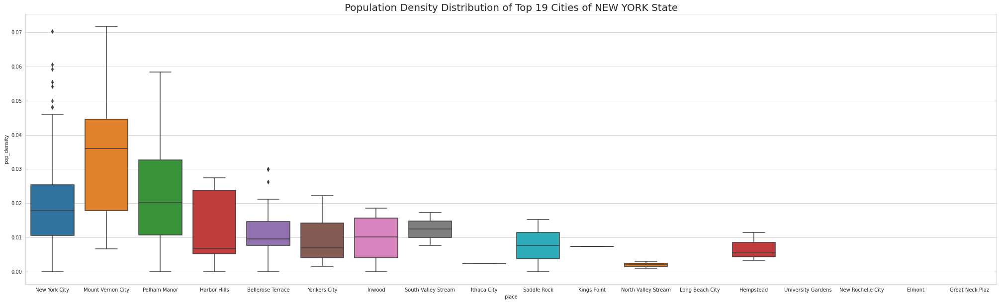

In [63]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))
sns.boxplot(x = 'place', y = 'pop_density', data=density_eda_df[density_eda_df['state'] == 'New York'].nlargest(26585, 'pop_density'), palette=color_pal, order = ['New York City',
 'Mount Vernon City',
 'Pelham Manor',
 'Harbor Hills',
 'Bellerose Terrace',
 'Yonkers City',
 'Inwood',
 'South Valley Stream',
 'Ithaca City',
 'Saddle Rock',
 'Kings Point',
 'North Valley Stream',
 'Long Beach City',
 'Hempstead',
 'University Gardens',
 'New Rochelle City',
 'Elmont',
 'Great Neck Plaz']
).set_title('Population Density Distribution of Top 19 Cities of NEW YORK State', fontsize = 20)
plt.show()

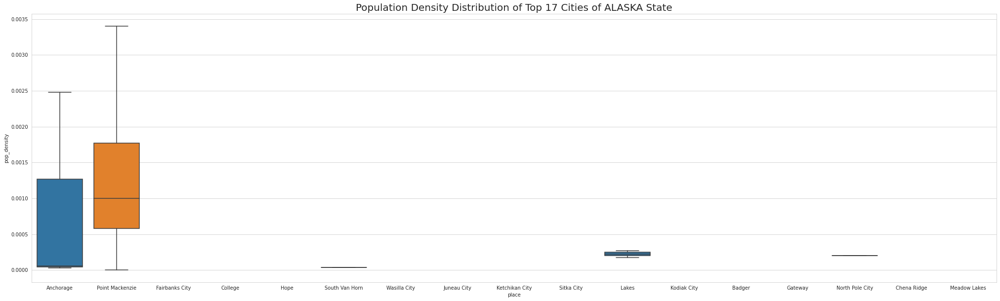

In [64]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))
sns.boxplot(x = 'place', y = 'pop_density', data=density_eda_df[density_eda_df['state'] == 'Alaska'].nlargest(26585, 'pop_density'), palette=color_pal, order = ['Anchorage', 'Point Mackenzie', 'Fairbanks City', 'College', 'Hope', 'South Van Horn', 
                                                                                                                                                                                    'Wasilla City', 'Juneau City', 'Ketchikan City', 'Sitka City', 'Lakes', 'Kodiak City', 'Badger', 'Gateway', 'North Pole City', 'Chena Ridge', 'Meadow Lakes']
).set_title('Population Density Distribution of Top 17 Cities of ALASKA State', fontsize = 20)
plt.show()

In [65]:
print(list(density_eda_df.nlargest(450, 'median_age').state.unique()))
print(len(list(density_eda_df.nlargest(450, 'median_age').state.unique())))

['Pennsylvania', 'Florida', 'Arizona', 'California', 'New York', 'New Jersey', 'Nevada', 'Texas', 'Minnesota', 'Wisconsin', 'Ohio', 'North Carolina', 'Delaware', 'Washington', 'Illinois', 'Missouri', 'South Carolina', 'Virginia', 'Michigan', 'New Mexico', 'Oregon', 'Connecticut', 'Georgia', 'Massachusetts', 'Maine', 'Alabama', 'Arkansas', 'Idaho', 'Colorado', 'Oklahoma', 'Maryland', 'Nebraska', 'Hawaii', 'New Hampshire', 'Louisiana', 'Montana', 'Rhode Island', 'Puerto Rico', 'North Dakota', 'Vermont', 'Kansas', 'Tennessee', 'South Dakota', 'Kentucky', 'Iowa']
45


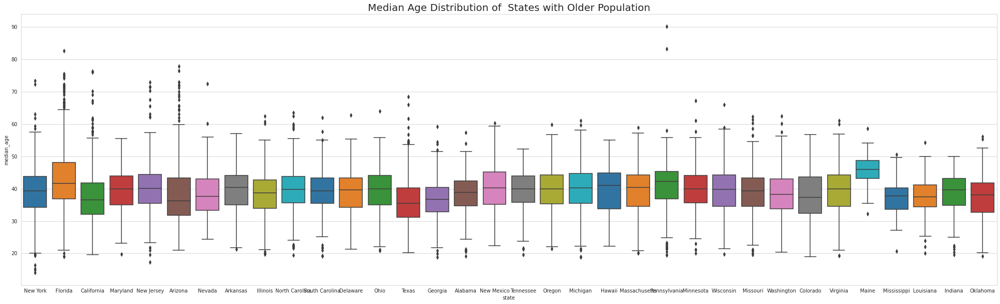

In [66]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))


ax = sns.boxplot(x = 'state', y = 'median_age', data=density_eda_df.nlargest(26585, 'median_age'), palette=color_pal, 
            order = ['New York', 'Florida', 'California', 'Maryland', 'New Jersey', 'Arizona', 'Nevada', 'Arkansas', 'Illinois', 'North Carolina', 'South Carolina', 'Delaware', 'Ohio', 'Texas', 'Georgia', 'Alabama', 'New Mexico', 'Tennessee', 
            'Oregon', 'Michigan', 'Hawaii', 'Massachusetts', 'Pennsylvania', 'Minnesota', 'Wisconsin', 'Missouri', 'Washington', 'Colorado', 'Virginia', 'Maine', 'Mississippi', 'Louisiana', 'Indiana', 'Oklahoma']
           ).set_title('Median Age Distribution of  States with Older Population', fontsize = 20)

#ax.set(ylim=(0, 100))

plt.show()

### 2. Create bins for population into a new variable by selecting appropriate class interval so that the number of categories don’t exceed 5 for the ease of analysis.

#### a) Analyze the married, separated, and divorced population for these population brackets

#### b) Visualize using appropriate chart type

In [67]:
age_df = train_df[['state', 'city', 'place', 'pop', 'male_pop', 'female_pop', 'male_age_median', 'female_age_median', 'married', 'separated', 'divorced']]

In [68]:
bins = [0, 12,18, 35, 55, 100]
labels = ['kids', 'Youth', 'Young Adult', 'Adult', 'Senior']

In [69]:
age_df['male_population_bracket'] = pd.cut(age_df['male_age_median'], bins, labels = labels)
age_df['female_population_bracket'] = pd.cut(age_df['female_age_median'], bins, labels = labels)

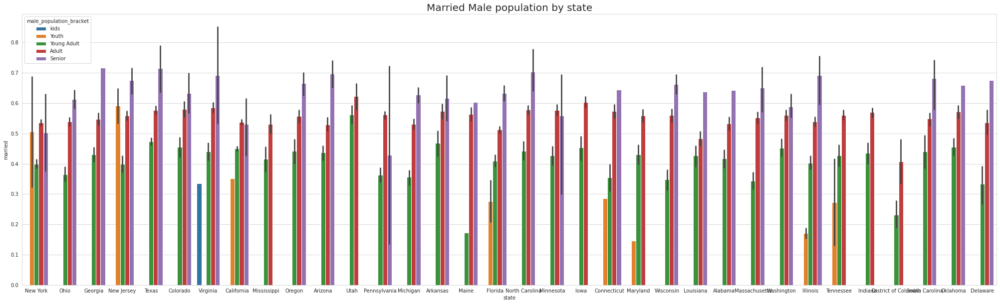

In [70]:
sns.set_style("whitegrid")

plt.figure(figsize = (35, 10))

ax = sns.barplot(x = 'state', y = 'married', hue = 'male_population_bracket', data = age_df, palette=color_pal, 
           order = ['New York', 'Ohio', 'Georgia', 'New Jersey', 'Texas', 'Colorado', 'Virginia', 'California', 'Mississippi', 'Oregon', 'Arizona', 'Utah', 'Pennsylvania', 'Michigan', 'Arkansas', 'Maine', 'Florida', 'North Carolina', 
                     'Minnesota', 'Iowa', 'Connecticut', 'Maryland', 'Wisconsin', 'Louisiana', 'Alabama', 'Massachusetts', 'Washington', 'Illinois', 'Tennessee', 'Indiana', 'District of Columbia', 'South Carolina', 'Oklahoma', 'Delaware'])

ax.set_title('Married Male population by state', fontsize = 20)

plt.show()


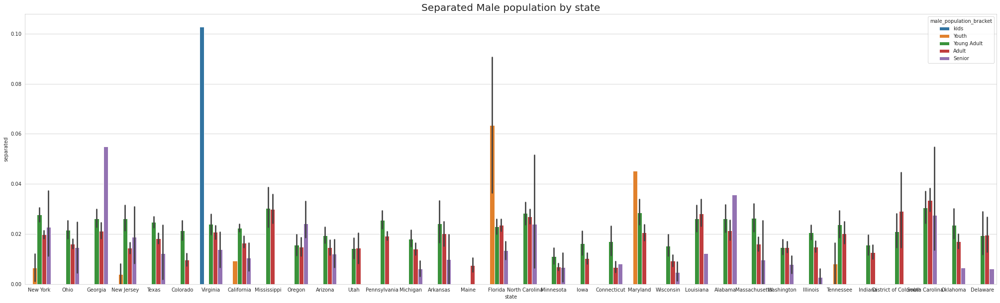

In [71]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))

ax = sns.barplot(x = 'state', y = 'separated', hue = 'male_population_bracket', data = age_df, palette=color_pal, 
           order = ['New York', 'Ohio', 'Georgia', 'New Jersey', 'Texas', 'Colorado', 'Virginia', 'California', 'Mississippi', 'Oregon', 'Arizona', 'Utah', 'Pennsylvania', 'Michigan', 'Arkansas', 'Maine', 'Florida', 'North Carolina', 
                     'Minnesota', 'Iowa', 'Connecticut', 'Maryland', 'Wisconsin', 'Louisiana', 'Alabama', 'Massachusetts', 'Washington', 'Illinois', 'Tennessee', 'Indiana', 'District of Columbia', 'South Carolina', 'Oklahoma', 'Delaware'])

ax.set_title('Separated Male population by state', fontsize = 20)

plt.show()

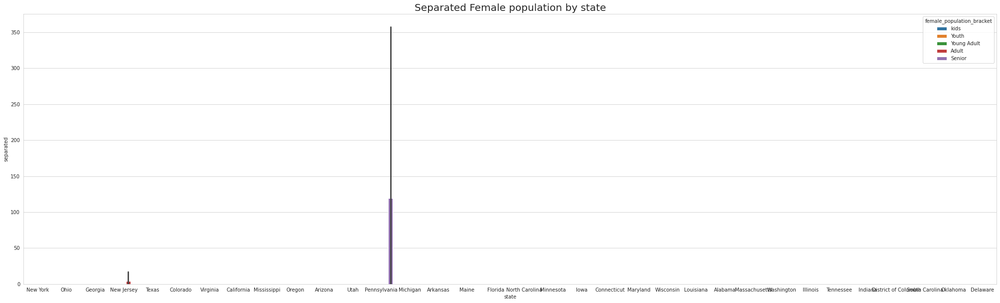

In [72]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))

ax = sns.barplot(x = 'state', y = 'separated', hue = 'female_population_bracket', data = age_df, palette=color_pal, 
           order = ['New York', 'Ohio', 'Georgia', 'New Jersey', 'Texas', 'Colorado', 'Virginia', 'California', 'Mississippi', 'Oregon', 'Arizona', 'Utah', 'Pennsylvania', 'Michigan', 'Arkansas', 'Maine', 'Florida', 'North Carolina', 
                     'Minnesota', 'Iowa', 'Connecticut', 'Maryland', 'Wisconsin', 'Louisiana', 'Alabama', 'Massachusetts', 'Washington', 'Illinois', 'Tennessee', 'Indiana', 'District of Columbia', 'South Carolina', 'Oklahoma', 'Delaware'])

ax.set_title('Separated Female population by state', fontsize = 20)

plt.show()

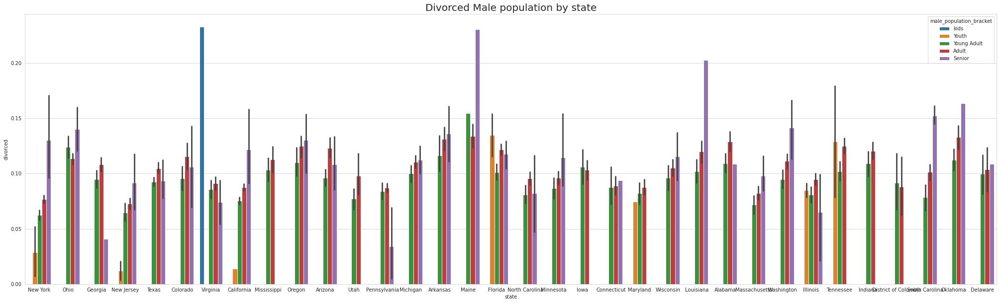

In [73]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))

ax = sns.barplot(x = 'state', y = 'divorced', hue = 'male_population_bracket', data = age_df, palette=color_pal, 
           order = ['New York', 'Ohio', 'Georgia', 'New Jersey', 'Texas', 'Colorado', 'Virginia', 'California', 'Mississippi', 'Oregon', 'Arizona', 'Utah', 'Pennsylvania', 'Michigan', 'Arkansas', 'Maine', 'Florida', 'North Carolina', 
                     'Minnesota', 'Iowa', 'Connecticut', 'Maryland', 'Wisconsin', 'Louisiana', 'Alabama', 'Massachusetts', 'Washington', 'Illinois', 'Tennessee', 'Indiana', 'District of Columbia', 'South Carolina', 'Oklahoma', 'Delaware'])

ax.set_title('Divorced Male population by state', fontsize = 20)

plt.show()

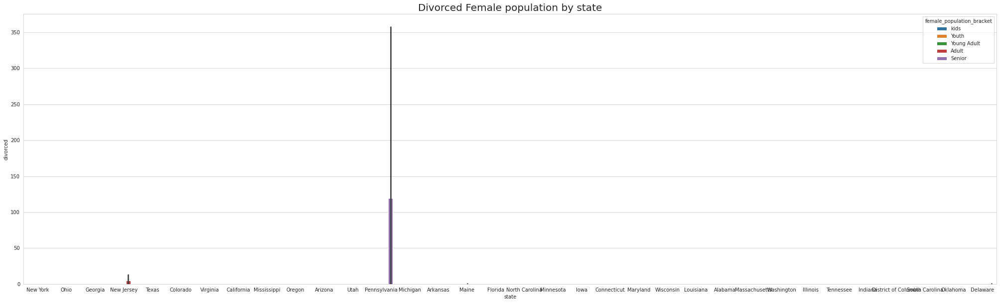

In [74]:
sns.set_style("whitegrid")

plt.figure(figsize = (35, 10))

ax = sns.barplot(x = 'state', y = 'divorced', hue = 'female_population_bracket', data = age_df, palette=color_pal, 
           order = ['New York', 'Ohio', 'Georgia', 'New Jersey', 'Texas', 'Colorado', 'Virginia', 'California', 'Mississippi', 'Oregon', 'Arizona', 'Utah', 'Pennsylvania', 'Michigan', 'Arkansas', 'Maine', 'Florida', 'North Carolina', 
                     'Minnesota', 'Iowa', 'Connecticut', 'Maryland', 'Wisconsin', 'Louisiana', 'Alabama', 'Massachusetts', 'Washington', 'Illinois', 'Tennessee', 'Indiana', 'District of Columbia', 'South Carolina', 'Oklahoma', 'Delaware'])

ax.set_title('Divorced Female population by state', fontsize = 20)

plt.show()


### 3) . Please detail your observations for rent as a percentage of income at an overall level, and for different states.

In [75]:
rent_df = train_df[['state', 'city', 'rent_median', 'hi_median', 'family_median']]

In [76]:
Overall_rent_percentage = (rent_df['rent_median'].sum() / rent_df['hi_median'].sum()) * 100
round(Overall_rent_percentage, 2)

1.77

In [77]:
rent_df['ov_rent_pcnt'] = round((rent_df['rent_median'] / rent_df['hi_median']) * 100, 2)

In [78]:
rent_df.head()

,state,city,rent_median,hi_median,family_median,ov_rent_pcnt
0,Michigan,Detroit,859.0,38746.0,45167.0,2.22
1,Maine,Auburn,750.0,61008.0,74759.0,1.23
2,Pennsylvania,Pine City,755.0,51648.0,57186.0,1.46
3,Kentucky,Monticello,385.0,31612.0,34687.0,1.22
4,Texas,Corpus Christi,997.0,94211.0,103898.0,1.06


In [79]:
print(list(rent_df.nlargest(500, 'ov_rent_pcnt').state.unique()))
print(len(list(rent_df.nlargest(500, 'ov_rent_pcnt').state.unique())))

['Kansas', 'Tennessee', 'Michigan', 'New York', 'Hawaii', 'Louisiana', 'North Carolina', 'Texas', 'South Carolina', 'California', 'Nevada', 'Pennsylvania', 'Utah', 'Indiana', 'Florida', 'Puerto Rico', 'Missouri', 'Arizona', 'Delaware', 'Oklahoma', 'Colorado', 'Mississippi', 'New Jersey', 'Ohio', 'Virginia', 'Georgia', 'Illinois', 'Minnesota', 'Maryland', 'Vermont', 'Connecticut', 'Nebraska', 'Rhode Island', 'Massachusetts', 'Arkansas', 'Alabama', 'West Virginia', 'New Mexico', 'Oregon', 'Wisconsin', 'Kentucky', 'Washington', 'Iowa', 'District of Columbia']
44


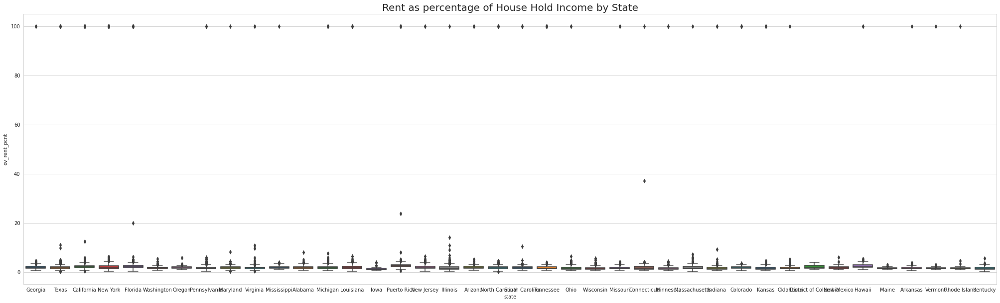

In [80]:
sns.set_style("whitegrid")
plt.figure(figsize = (35, 10))
ax = sns.boxplot(x = 'state', y = 'ov_rent_pcnt', data=rent_df.nlargest(26585, 'ov_rent_pcnt'), palette=color_pal, 
            order = ['Georgia', 'Texas', 'California', 'New York', 'Florida', 'Washington', 'Oregon', 'Pennsylvania', 'Maryland', 'Virginia', 'Mississippi', 'Alabama', 'Michigan', 'Louisiana', 
                     'Iowa', 'Puerto Rico', 'New Jersey', 'Illinois', 'Arizona', 'North Carolina', 'South Carolina', 'Tennessee', 'Ohio', 'Wisconsin', 'Missouri', 'Connecticut', 'Minnesota', 
                     'Massachusetts', 'Indiana', 'Colorado', 'Kansas', 'Oklahoma', 'District of Columbia', 'New Mexico', 'Hawaii', 'Maine', 'Arkansas', 'Vermont', 'Rhode Island', 'Kentucky']
           ).set_title('Rent as percentage of House Hold Income by State', fontsize = 20)
#ax.set(ylim=(0, 100))
plt.show()

### 4) Perform correlation analysis for all the relevant variables by creating a heatmap. Describe your findings.

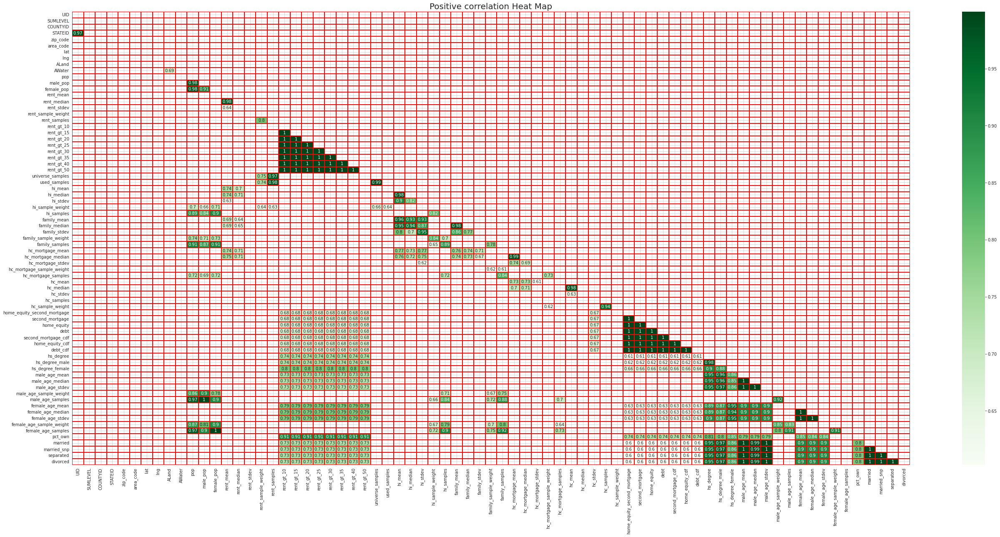

In [81]:
sns.set_style("whitegrid")

corr = train_df.corr()

mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

kot = corr[corr>=.6]
plt.figure(figsize=(45,20))
sns.heatmap(kot, cmap="Greens", annot = True, mask = mask, linewidths=1, linecolor='red').set_title('Positive correlation Heat Map', fontsize = 20)
plt.grid('on', )
plt.show()

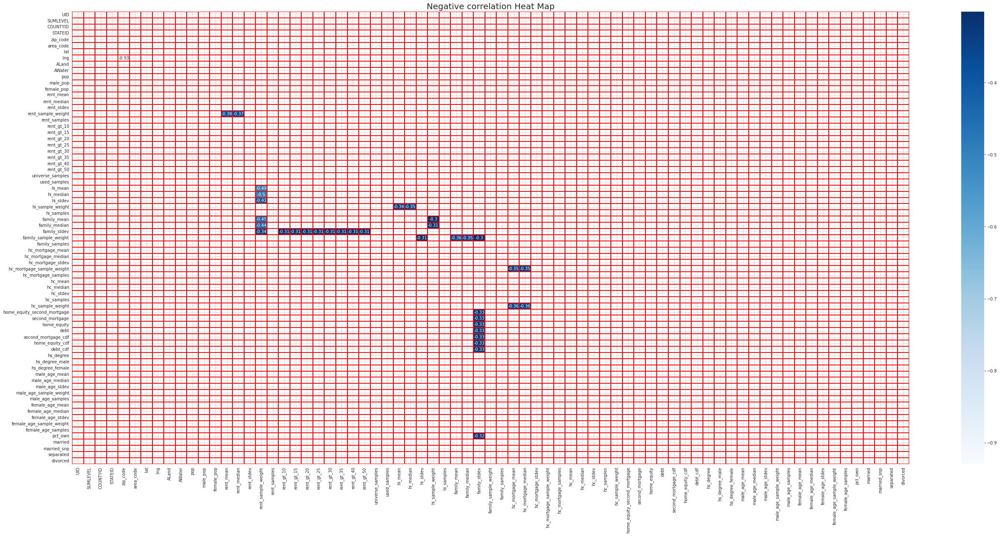

In [82]:
sns.set_style("whitegrid")
kot = corr[corr <=-.3]
plt.figure(figsize=(45,20))
sns.heatmap(kot, cmap="Blues", annot = True, mask = mask, linewidths=1, linecolor='red').set_title('Negative correlation Heat Map', fontsize = 20)
plt.grid('on', )
plt.show()


## Data Preprocessing

In [83]:
train_df.columns

Index(['UID', 'SUMLEVEL', 'COUNTYID', 'STATEID', 'state', 'state_ab', 'city',
       'place', 'type', 'primary', 'zip_code', 'area_code', 'lat', 'lng',
       'ALand', 'AWater', 'pop', 'male_pop', 'female_pop', 'rent_mean',
       'rent_median', 'rent_stdev', 'rent_sample_weight', 'rent_samples',
       'rent_gt_10', 'rent_gt_15', 'rent_gt_20', 'rent_gt_25', 'rent_gt_30',
       'rent_gt_35', 'rent_gt_40', 'rent_gt_50', 'universe_samples',
       'used_samples', 'hi_mean', 'hi_median', 'hi_stdev', 'hi_sample_weight',
       'hi_samples', 'family_mean', 'family_median', 'family_stdev',
       'family_sample_weight', 'family_samples', 'hc_mortgage_mean',
       'hc_mortgage_median', 'hc_mortgage_stdev', 'hc_mortgage_sample_weight',
       'hc_mortgage_samples', 'hc_mean', 'hc_median', 'hc_stdev', 'hc_samples',
       'hc_sample_weight', 'home_equity_second_mortgage', 'second_mortgage',
       'home_equity', 'debt', 'second_mortgage_cdf', 'home_equity_cdf',
       'debt_cdf', 'hs_degree',

In [84]:
train_df['Bad_Debt'] = train_df['second_mortgage'] + train_df['home_equity'] - train_df['home_equity_second_mortgage']

In [85]:
for col in train_df.columns:
    print(col,' = ' ,train_df[col].dtype)

UID  =  int64
SUMLEVEL  =  int64
COUNTYID  =  int64
STATEID  =  int64
state  =  object
state_ab  =  object
city  =  object
place  =  object
type  =  object
primary  =  object
zip_code  =  int64
area_code  =  int64
lat  =  float64
lng  =  float64
ALand  =  float64
AWater  =  int64
pop  =  int64
male_pop  =  int64
female_pop  =  int64
rent_mean  =  float64
rent_median  =  float64
rent_stdev  =  float64
rent_sample_weight  =  float64
rent_samples  =  float64
rent_gt_10  =  float64
rent_gt_15  =  float64
rent_gt_20  =  float64
rent_gt_25  =  float64
rent_gt_30  =  float64
rent_gt_35  =  float64
rent_gt_40  =  float64
rent_gt_50  =  float64
universe_samples  =  int64
used_samples  =  int64
hi_mean  =  float64
hi_median  =  float64
hi_stdev  =  float64
hi_sample_weight  =  float64
hi_samples  =  float64
family_mean  =  float64
family_median  =  float64
family_stdev  =  float64
family_sample_weight  =  float64
family_samples  =  float64
hc_mortgage_mean  =  float64
hc_mortgage_median  =  floa

In [86]:
def cat_variables(df):
    cat_variables = list(df.select_dtypes(exclude = ['int', 'float']).columns)
    return cat_variables

In [87]:
def num_variables(df):
    num_variables = list(df.select_dtypes(include = ['int', 'float']).columns)
    return num_variables

In [88]:
cat_variables(train_df)

['state', 'state_ab', 'city', 'place', 'type', 'primary', 'data type']

In [89]:
num_variables(train_df)

['UID',
 'SUMLEVEL',
 'COUNTYID',
 'STATEID',
 'zip_code',
 'area_code',
 'lat',
 'lng',
 'ALand',
 'AWater',
 'pop',
 'male_pop',
 'female_pop',
 'rent_mean',
 'rent_median',
 'rent_stdev',
 'rent_sample_weight',
 'rent_samples',
 'rent_gt_10',
 'rent_gt_15',
 'rent_gt_20',
 'rent_gt_25',
 'rent_gt_30',
 'rent_gt_35',
 'rent_gt_40',
 'rent_gt_50',
 'universe_samples',
 'used_samples',
 'hi_mean',
 'hi_median',
 'hi_stdev',
 'hi_sample_weight',
 'hi_samples',
 'family_mean',
 'family_median',
 'family_stdev',
 'family_sample_weight',
 'family_samples',
 'hc_mortgage_mean',
 'hc_mortgage_median',
 'hc_mortgage_stdev',
 'hc_mortgage_sample_weight',
 'hc_mortgage_samples',
 'hc_mean',
 'hc_median',
 'hc_stdev',
 'hc_samples',
 'hc_sample_weight',
 'home_equity_second_mortgage',
 'second_mortgage',
 'home_equity',
 'debt',
 'second_mortgage_cdf',
 'home_equity_cdf',
 'debt_cdf',
 'hs_degree',
 'hs_degree_male',
 'hs_degree_female',
 'male_age_mean',
 'male_age_median',
 'male_age_stdev',
 

In [90]:
fa_train_df = train_df[['hs_degree','male_age_median','female_age_median','second_mortgage_cdf','pct_own','Bad_Debt']]
fa_train_df

,hs_degree,male_age_median,female_age_median,second_mortgage_cdf,pct_own,Bad_Debt
0,0.91047,27.83333,33.75000,0.14111,0.70252,0.07651
1,0.94290,46.08333,46.66667,0.52310,0.85128,0.14375
2,0.89238,41.91667,44.50000,0.51066,0.81897,0.06744
3,0.60908,43.00000,48.00000,0.53770,0.84609,0.01741
4,0.86297,43.75000,42.66667,1.00000,0.79077,0.03440
5,0.95817,49.58333,52.58333,0.42953,0.71874,0.06476
6,0.84023,39.75000,45.75000,0.09313,0.63457,0.16535
7,0.86201,47.75000,44.91667,0.40874,0.82905,0.11396
8,0.73609,29.00000,26.58333,1.00000,0.16037,0.00000
9,0.80186,47.25000,40.41667,0.53625,0.73795,0.05743


In [91]:
!pip install factor_analyzer 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 41 kB 535 kB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 199 kB 8.1 MB/s 
     |████████████████████████████████| 8.8 MB 46.7 MB/s 
     |████████████████████████████████| 98 kB 8.0 MB/s 
     |████████████████████████████████| 468 kB 57.8 MB/s 
  Created wheel for factor-analyzer: filename=factor_analyzer-0.4.1-py2.py3-none-any.whl size=42034 sha256=6d06663172154e48003a9089195e3c2d09fd14c0e970c753739e96d1110ff2f9
  Stored in directory: /root/.cache/pip/wheels/ed/90/48/766e09628cc5bbcf57c2eb063972c1e956a03422dd6d84fde2
Successfully built factor-analyzer


In [92]:
from factor_analyzer import FactorAnalyzer


In [93]:
# Create factor analysis object and perform factor analysis
fa = FactorAnalyzer( rotation=None, n_factors = 25)
fa.fit(fa_train_df)
# Check Eigenvalues
ev, v = fa.get_eigenvalues()
ev

array([4.78345063e+00, 8.63732454e-01, 1.98837441e-01, 1.05669636e-01,
       4.83062224e-02, 3.61447640e-06])

In [94]:
loadings = fa.loadings_

In [95]:
xvals = range(1, fa_train_df.shape[1]+1)

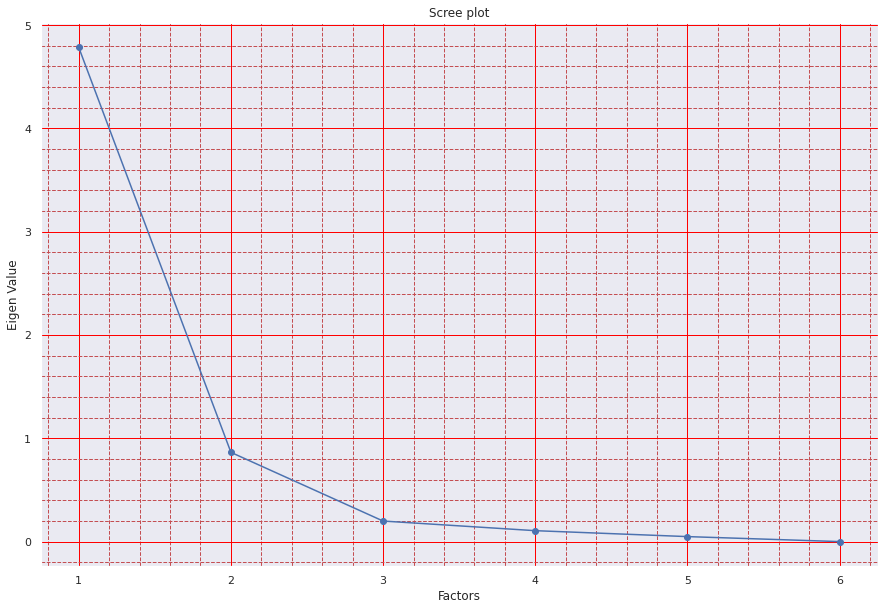

In [96]:
sns.set()
plt.figure(figsize = (15,10))
plt.scatter(xvals, ev)
plt.plot(xvals, ev)
plt.title('Scree plot')
plt.xlabel('Factors')
plt.ylabel('Eigen Value')
plt.grid(color = 'red', )
plt.grid(b=True, which='minor', color='r', linestyle='--')
plt.minorticks_on()
plt.show()


In [97]:
Factors  = pd.DataFrame.from_records(loadings)

Factors = Factors.add_prefix('Factor ')

Factors.index = fa_train_df.columns
Factors

,Factor 0,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5
hs_degree,0.912198,-0.317482,0.109488,-0.096088,0.0,0.0
male_age_median,0.904513,-0.358161,0.142455,0.061471,0.0,0.0
female_age_median,0.909585,-0.269236,-0.141659,0.079271,0.0,0.0
second_mortgage_cdf,0.851478,0.520345,0.040193,0.010428,0.0,0.0
pct_own,0.894808,-0.030913,-0.188109,-0.064615,0.0,0.0
Bad_Debt,0.851481,0.520341,0.040191,0.010434,0.0,0.0


In [98]:
fa = FactorAnalyzer( rotation="varimax", n_factors = 12)
fa.fit(fa_train_df)
loadings = fa.loadings_

In [99]:
Factors  = pd.DataFrame.from_records(loadings)

Factors = Factors.add_prefix('Factor ')

Factors.index = fa_train_df.columns
Factors

,Factor 0,Factor 1,Factor 2,Factor 3,Factor 4,Factor 5
hs_degree,0.909562,0.336376,0.017646,-0.115580,0.0,0.0
male_age_median,0.934926,0.304911,-0.049868,0.030823,0.0,0.0
female_age_median,0.858393,0.357391,0.222046,0.110961,0.0,0.0
second_mortgage_cdf,0.326799,0.942204,0.054308,0.001915,0.0,0.0
pct_own,0.689361,0.526651,0.297044,-0.019544,0.0,0.0
Bad_Debt,0.326804,0.942202,0.054308,0.001922,0.0,0.0


## **Data Modelling**

In [100]:
train_df.isnull().sum()

UID                            0
SUMLEVEL                       0
COUNTYID                       0
STATEID                        0
state                          0
state_ab                       0
city                           0
place                          0
type                           0
primary                        0
zip_code                       0
area_code                      0
lat                            0
lng                            0
ALand                          0
AWater                         0
pop                            0
male_pop                       0
female_pop                     0
rent_mean                      0
rent_median                    0
rent_stdev                     0
rent_sample_weight             0
rent_samples                   0
rent_gt_10                     0
rent_gt_15                     0
rent_gt_20                     0
rent_gt_25                     0
rent_gt_30                     0
rent_gt_35                     0
rent_gt_40

In [101]:
test_df.isnull().sum()

UID                            0
SUMLEVEL                       0
COUNTYID                       0
STATEID                        0
state                          0
state_ab                       0
city                           0
place                          0
type                           0
primary                        0
zip_code                       0
area_code                      0
lat                            0
lng                            0
ALand                          0
AWater                         0
pop                            0
male_pop                       0
female_pop                     0
rent_mean                      0
rent_median                    0
rent_stdev                     0
rent_sample_weight             0
rent_samples                   0
rent_gt_10                     0
rent_gt_15                     0
rent_gt_20                     0
rent_gt_25                     0
rent_gt_30                     0
rent_gt_35                     0
rent_gt_40

In [102]:
train_df['Bad_Debt'] = train_df['second_mortgage'] + train_df['home_equity'] - train_df['home_equity_second_mortgage']

In [103]:
test_df['Bad_Debt'] = test_df['second_mortgage'] + test_df['home_equity'] - test_df['home_equity_second_mortgage']

In [104]:
train_df['Population_Density'] = train_df['pop'] / train_df['ALand']

In [105]:
test_df['Population_Density'] = test_df['pop'] / test_df['ALand']

In [106]:
feature_col = ['ALand', 'AWater', 'pop', 'male_pop', 'female_pop', 'rent_mean','rent_median','Population_Density','Bad_Debt','hi_mean','family_mean','hc_mean','hs_degree',\
               'male_age_mean','female_age_mean']

In [107]:
X_train = train_df[feature_col]
y_train = train_df['hc_mortgage_mean']

In [108]:
X_test = test_df[feature_col]
y_test = test_df['hc_mortgage_mean']

In [109]:
X_train.corr()

,ALand,AWater,pop,male_pop,female_pop,rent_mean,rent_median,Population_Density,Bad_Debt,hi_mean,family_mean,hc_mean,hs_degree,male_age_mean,female_age_mean
ALand,1.000000,0.692633,-0.025112,-0.010245,-0.038810,-0.095365,-0.092514,-0.060929,-0.001844,-0.041705,-0.040538,-0.076864,0.013995,0.017903,0.013130
AWater,0.692633,1.000000,-0.001172,0.004067,-0.006360,-0.019274,-0.018020,-0.014329,-0.003537,-0.007840,-0.008587,-0.014109,-0.001752,-0.000634,-0.002562
pop,-0.025112,-0.001172,1.000000,0.976516,0.976477,0.163440,0.155305,0.010376,-0.168021,0.201605,0.172987,0.006104,-0.167403,-0.180165,-0.183179
male_pop,-0.010245,0.004067,0.976516,1.000000,0.907092,0.157601,0.150274,-0.002137,-0.137796,0.195025,0.162401,0.003113,-0.161012,-0.174761,-0.169724
female_pop,-0.038810,-0.006360,0.976477,0.907092,1.000000,0.161598,0.153037,0.022412,-0.190369,0.198710,0.175447,0.008811,-0.165927,-0.177100,-0.188030
rent_mean,-0.095365,-0.019274,0.163440,0.157601,0.161598,1.000000,0.975675,0.159036,-0.002091,0.740626,0.686818,0.579991,-0.018372,-0.013358,-0.014916
rent_median,-0.092514,-0.018020,0.155305,0.150274,0.153037,0.975675,1.000000,0.157347,0.006993,0.704440,0.644179,0.551934,-0.009423,-0.005552,-0.006643
Population_Density,-0.060929,-0.014329,0.010376,-0.002137,0.022412,0.159036,0.157347,1.000000,0.052549,-0.033520,-0.028038,0.216152,-0.032118,-0.046776,-0.044700
Bad_Debt,-0.001844,-0.003537,-0.168021,-0.137796,-0.190369,-0.002091,0.006993,0.052549,1.000000,-0.206421,-0.232953,0.232585,0.614918,0.592885,0.631388
hi_mean,-0.041705,-0.007840,0.201605,0.195025,0.198710,0.740626,0.704440,-0.033520,-0.206421,1.000000,0.964570,0.581630,-0.177533,-0.156782,-0.171260


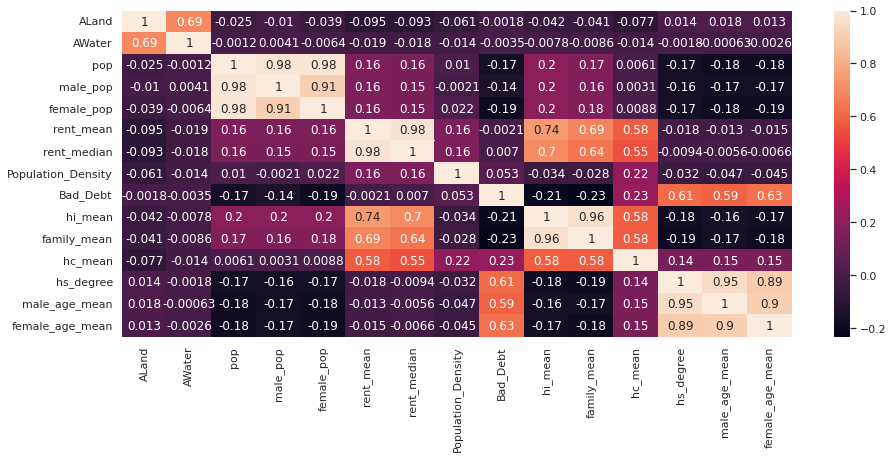

In [110]:
from scipy.stats.morestats import annotations
plt.figure(figsize = (15,6))
sns.heatmap(X_train.corr(), annot = True)

'pop' is highly correlated with male_pop and female_pop. So let's drop male_pop and female_pop.
'rent_mean' is highly correlated with rent_median. So let's drop rent_median.
'hs_degree' is highly correlated with male_age and female_age. Drop male_age and female_age

In [111]:
X_train.drop(['male_pop','female_pop','rent_median','male_age_mean','female_age_mean', 'hi_mean'] , axis =1, inplace = True)

In [112]:
X_test.drop(['male_pop','female_pop','rent_median','male_age_mean','female_age_mean','hi_mean'] , axis =1, inplace = True)

In [113]:
from sklearn.linear_model import LinearRegression

In [114]:
lr = LinearRegression()
lr.fit(X_train,y_train)

LinearRegression()

In [115]:
lr.score(X_test,y_test)

0.7977465624346949

In [116]:
pred = lr.predict(X_test)


In [117]:
from sklearn.metrics import r2_score

In [118]:
r2_score(y_test,pred)

0.7977465624346949

We have trained the model with 80% accuracy which is greater than the required accuracy.

In [121]:
train_df.to_excel("/content/drive/MyDrive/Colab Notebooks/output1.xlsx", sheet_name = 'Sheet1')
top_2500.to_excel("/content/drive/MyDrive/Colab Notebooks/output2500.xlsx", sheet_name = 'Sheet1')